# Screenplay Genre Classification

## EDA Part II

In [1]:
#importing necessary packages
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from nltk import FreqDist

In [2]:
data = pd.read_csv('data/cleaned_data.csv', index_col=[0])

In [3]:
data.head()

,title,text,genre,genre_amount,Crime,Romance,Animation,SciFi,Fantasy,History,...,War,Thriller,Mystery,Documentary,Horror,Family,Adventure,Music,Comedy,Western
0,Domino,b'D O M I N O\r\n...,"['Thriller', 'Action', 'Crime']",3,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
1,Knocked Up,b'KNOCKED UP\r\n\r\nWritten by\r\n\r\nJudd Apa...,"['Comedy', 'Romance', 'Drama']",3,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2,10 Things I Hate About You,b'TEN THINGS I HATE ABOUT YOU\r\n\r\nwritten b...,"['Comedy', 'Romance', 'Drama']",3,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
3,10000 B C,"b""10,000 B.C.\r\nby\r\nRoland Emmerich & Haral...","['Adventure', 'Action', 'Drama', 'Fantasy']",4,0,0,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
4,12 And Holding,b'12 AND HOLDING\r\n\r\nWritten by\r\n\r\nAnth...,['Drama'],1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [4]:
#creating genre list
genre_list = list(data.columns[-18:])

In [ ]:
#separating data by genre into a dictionary

genre_df =  {}

for i in genre_list:

    genre_df[i] = data[data[i] == 1]

### In this section, I create three functions for EDA. word_count() and getting_stops() is used to optimize the stop words list for preprocessing. The cloud() function is used to display a word cloud for each genre.

In [5]:
#function to create frequency dict
def word_count(genre=None, text='text'): #text can be subsituted for cleaned_text

    from nltk.corpus import stopwords

    stop_words = stopwords.words('english')
    

    """
    
    This function takes a genre and text as a paramter and returns the frequency dict for scripts in that genre.
    If no genre specified, then function takes a sample of all script text and returns a frequency dict.
    
    """
    if genre != None:
        all_text = " ".join(genre_df[genre][text])
        some_text = [text.lower() for text in all_text.split() if text.lower() not in stop_words]
        word_count = FreqDist(some_text)

    else:
        df_sample_text = data.text.sample(n=100, random_state=42)
        all_text = " ".join(df_sample_text)
        some_text = [text.lower() for text in all_text.split() if text.lower() not in stop_words]
        word_count = FreqDist(some_text)

    return word_count

In [6]:
#function to get most frequent words in freqdist

def getting_stops(freq_dist, num): 

    """
    This function takes in a frequency distrubtion and a number and returns the number of words by count.
    This function will help in created an optimial stop_word list.

    """
    
    stops = []
    
    for i in freq_dist.most_common(num):
        stops.append(i[0])

    return stops

In [7]:
#function to display word cloud

def cloud(words, genre=None, stops=None):

    """
    This function takes in script words, genre, and stops as arguments and returns a word cloud.
    
    """

    if genre == None:
        genre = 'All Genres'
    
    plt.figure(figsize=(40,25))
    # clean
    subset = words
    cloud = WordCloud(
                            stopwords=stops,
                            background_color='black',
                            collocations=True,
                            width=2500,
                            height=1800
                            ).generate(" ".join(subset))
    plt.axis('off')
    plt.title(genre,fontsize=40)
    plt.imshow(cloud)

In [ ]:
#word cloud before cleaning

cloud(data.text.sample(n=100, random_state=42))

In [ ]:
#word cloud before cleaning for each genre
from math import ceil

for i in genre_list:

    cloud(genre_df[i].text.sample(n=ceil(len(genre_df[i])/2)), genre=i)

#### Clearly, the word clouds before cleaning are ineligable and show no specification to either genre. I'll try cleaning the text to see if there is improvement.

In [8]:
#.py file to preprocess and clean text
from preprocessing import TextPreprocessor

#creating class object
tp = TextPreprocessor()

In [ ]:
#looping through each genre and cleaning text using custom textpreprocesser class

for i in genre_list:
    genre_df[i]['cleaned_text'] = genre_df[i].text.apply(lambda x: tp.the_cleaner(x))

In [ ]:
for i in genre_list:
    
    cloud(genre_df[i]['cleaned_text'], genre=i)

#### The cloud is more readable but provides no specification to any genre; they are all similar in context and words. Next, I'll apply a custom stop words list using the word_count function.

In [ ]:
#intializing dict
stops = {}

#gettting top 150 words in each genre
for i, x in enumerate(genre_list):
    stops[i] = set(getting_stops(word_count(genre=x, text='cleaned_text'), 300))

#### We'll use the intersection of the 300 most common words of each genre to generate a stop word list

In [ ]:
#finding the intersection of the stop lists for each genre
stopping = list(set.intersection(stops[0], stops[1], stops[2], stops[3],
stops[4], stops[5], stops[6], stops[7], stops[8], stops[9],
stops[10], stops[11], stops[12], stops[13], stops[14], stops[15],
stops[16], stops[17]))

In [10]:
#import stopword list
import itertools
from nltk.corpus import stopwords

#chains together common stop words with custom stopwords

In [ ]:
#looping through each genre and creating a word cloud with cleaned words and updated stopword list
for i in genre_list:
    
    cloud(genre_df[i].cleaned_text, stops=stopping_adjusted, genre=i)

#### The word clouds look a lot better. Now let's try elimanting names and lemmatizing the cleaned no stop words.

In [12]:
tp = TextPreprocessor(lem_or_stem='lem', activator_type='wnl') #initializing class object for lemmatizing

In [13]:
data['words'] = data.text.apply(lambda x: tp.lem_process_doc(x)) #lemmatizing

In [14]:
new_genre_df = {} #separing text by genre

for i in genre_list:
    new_genre_df[i] = data[data[i] == 1]

In [15]:
freq_dct = {} #creating a dict to store word frequency by genre

for i in genre_list:

    freq_dct[i] = FreqDist((" ".join(new_genre_df[i].words)).split())

In [17]:
lst = [] #list to append sets of top 500 genre words

for i in genre_list:
    
    lst.append(set(getting_stops(freq_dct[i], 500))) 

In [18]:
stops = list(set.intersection(*lst)) #finding the intersection

with open('data/names.txt') as f: #this file contains common names of people
    line = f.readlines()

for i in line:
    stops.append(i.strip('\n').lower()) #appending names

In [20]:
#applying new stop words to lemmatized text 
data['updated_words'] = data.words.apply(lambda x: stopping(x, stops))

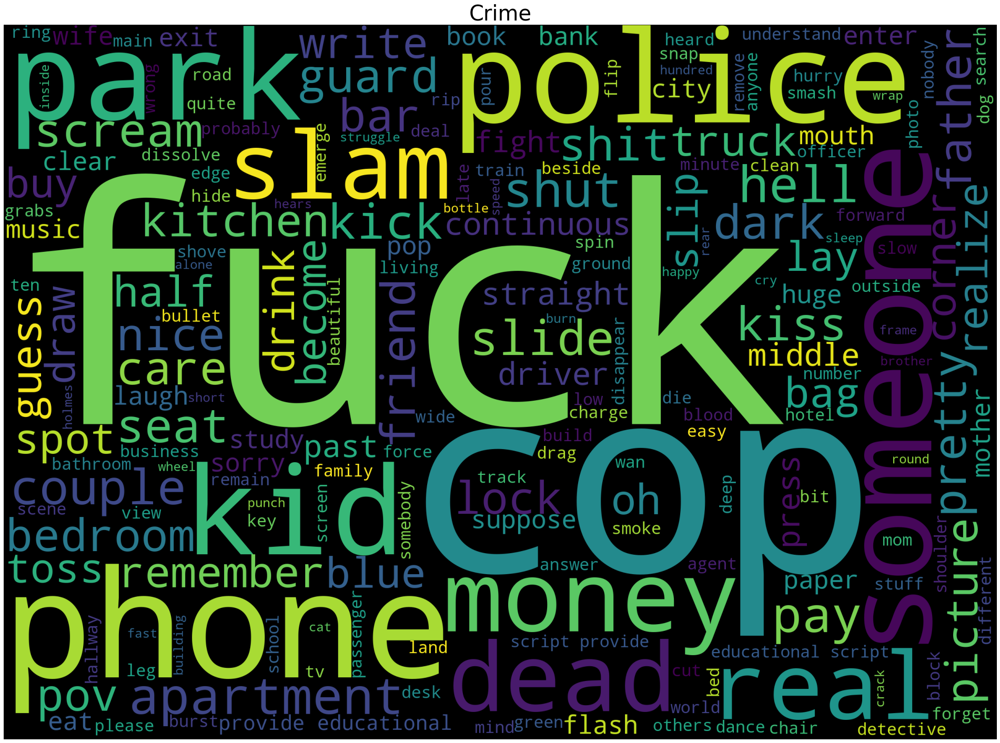

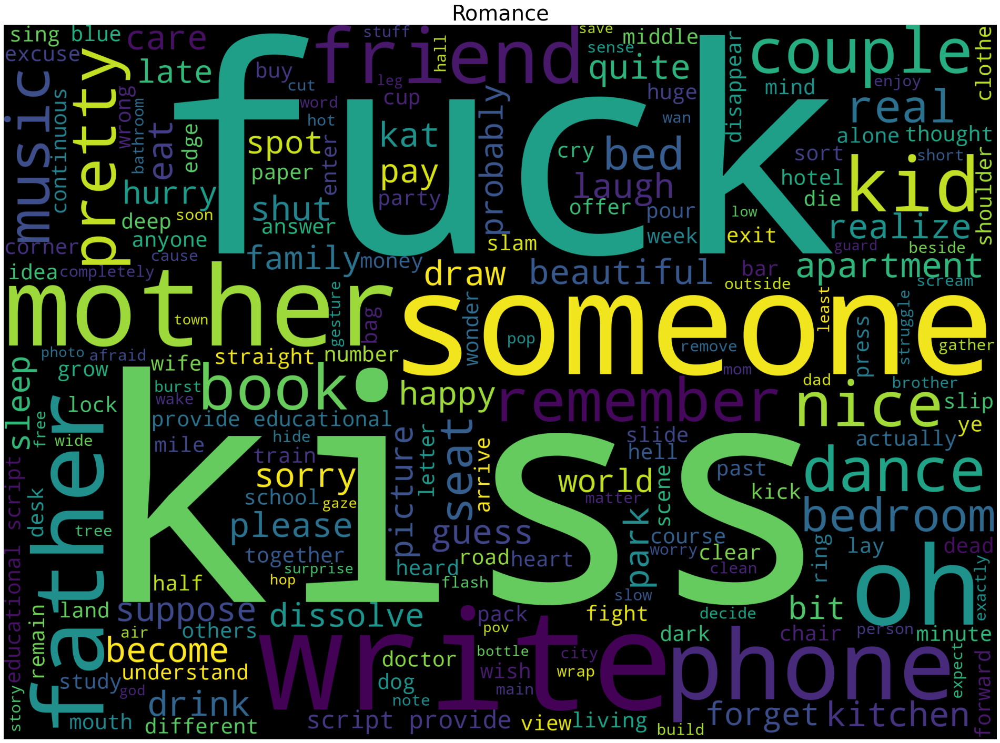

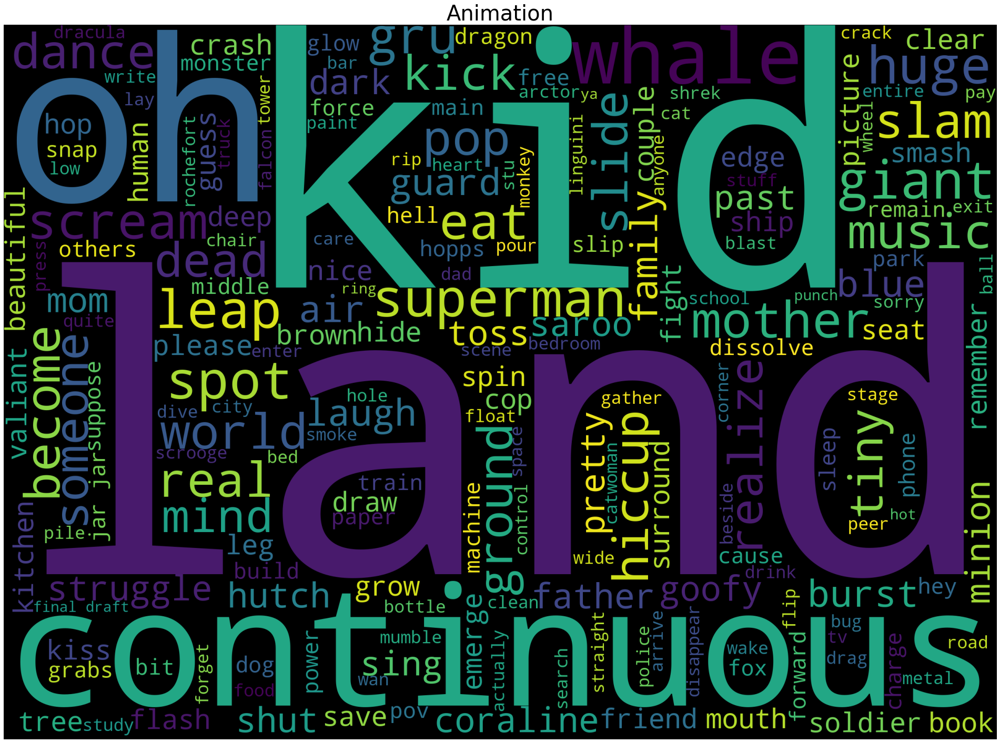

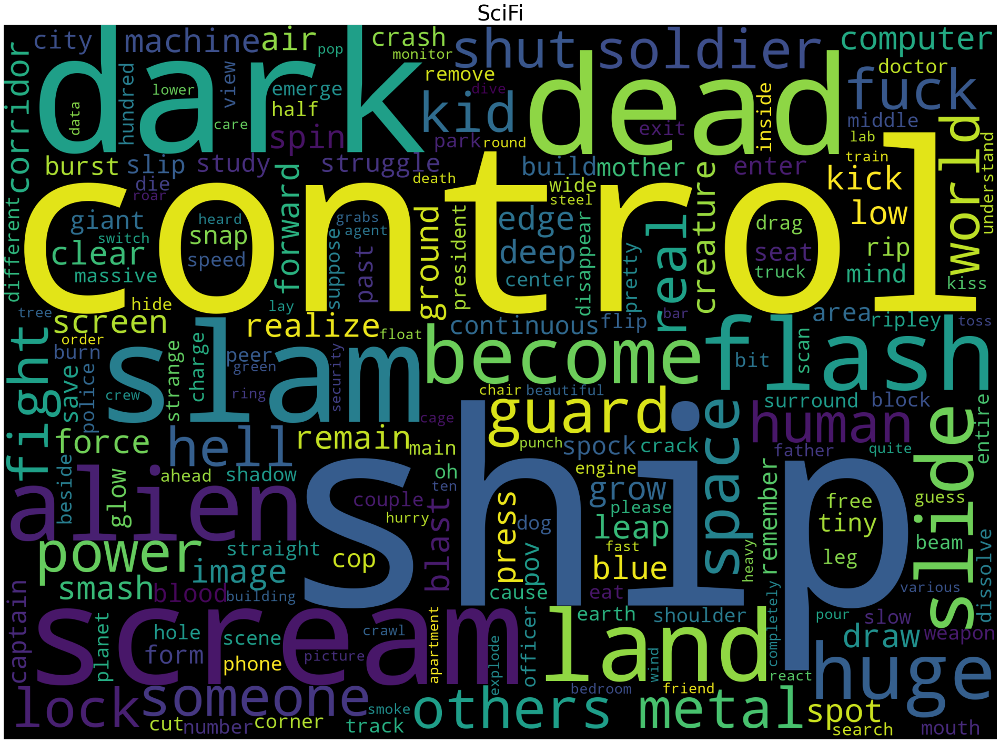

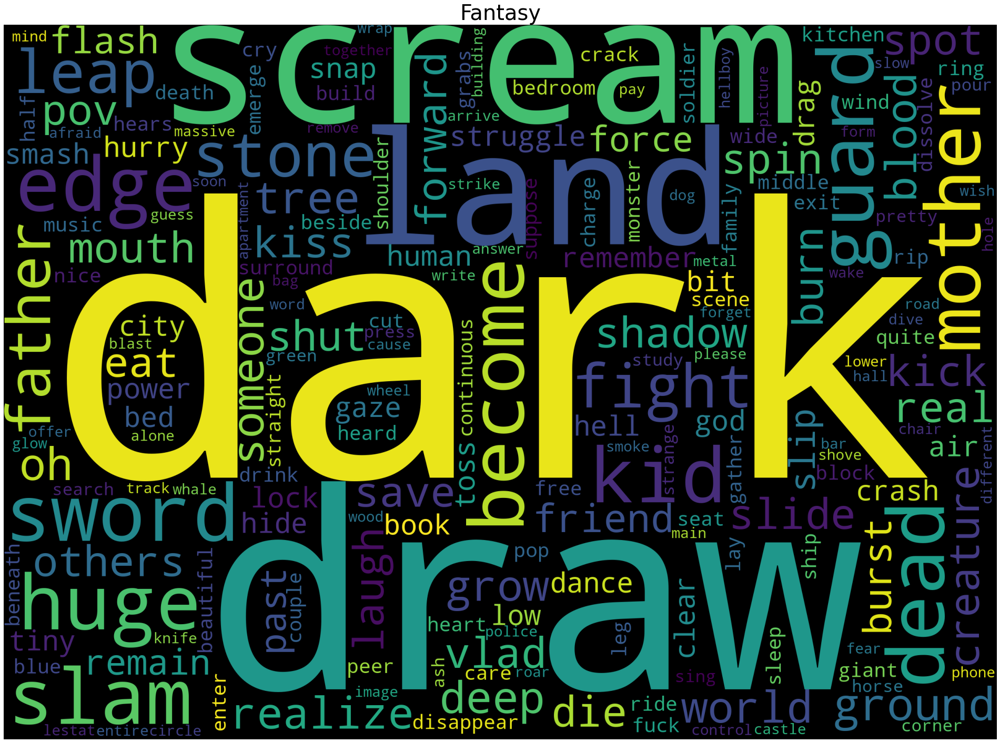

...

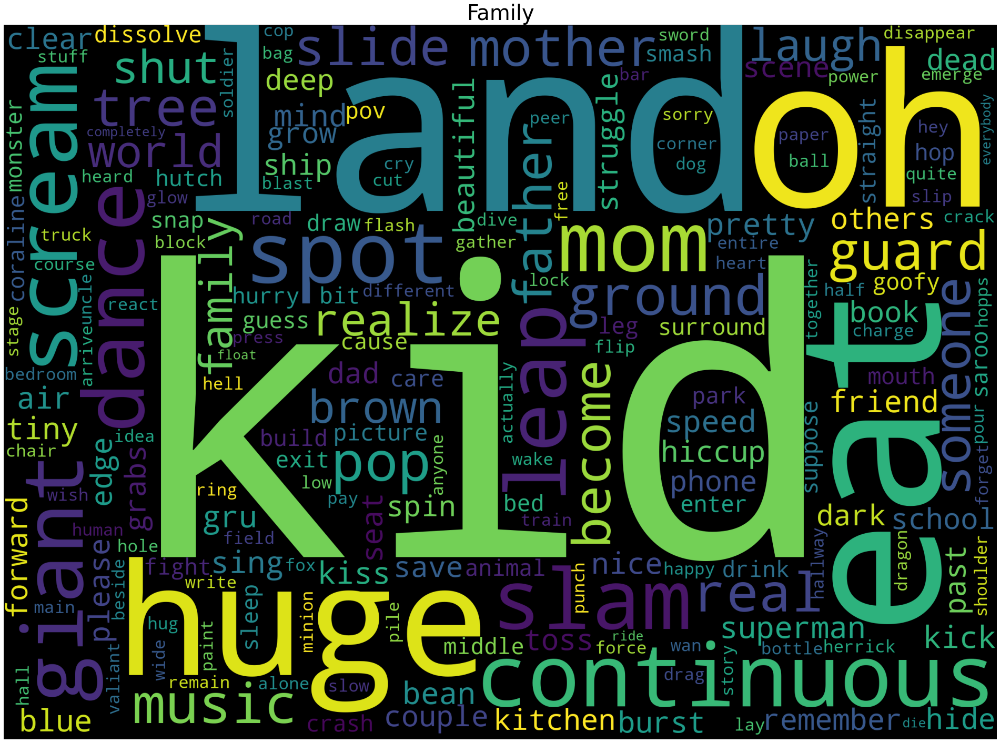

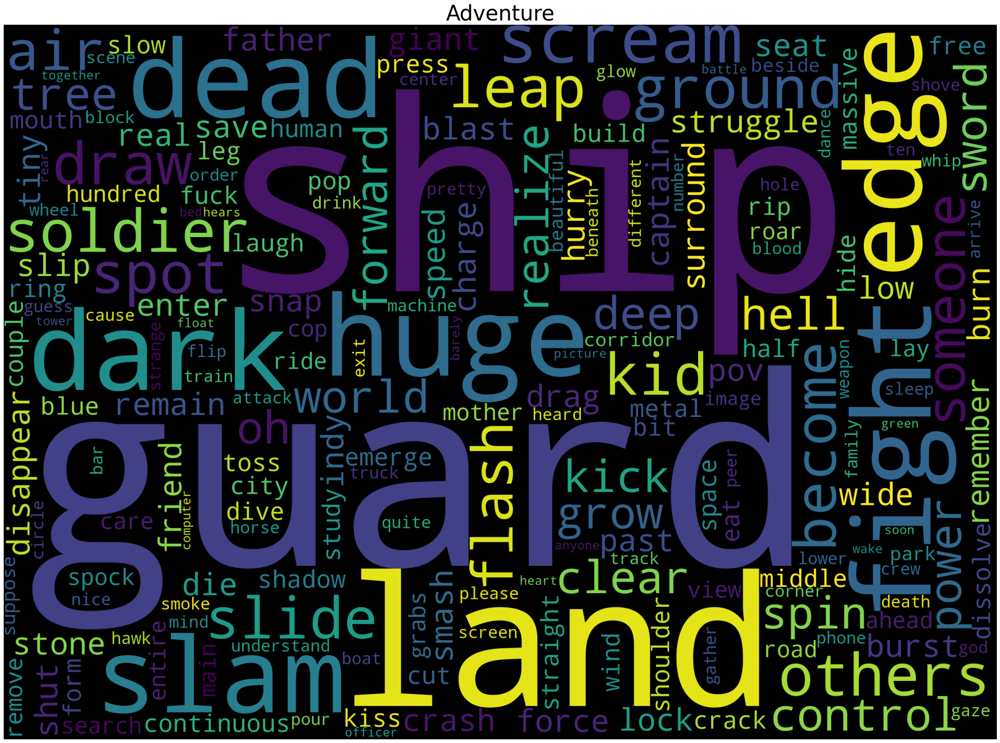

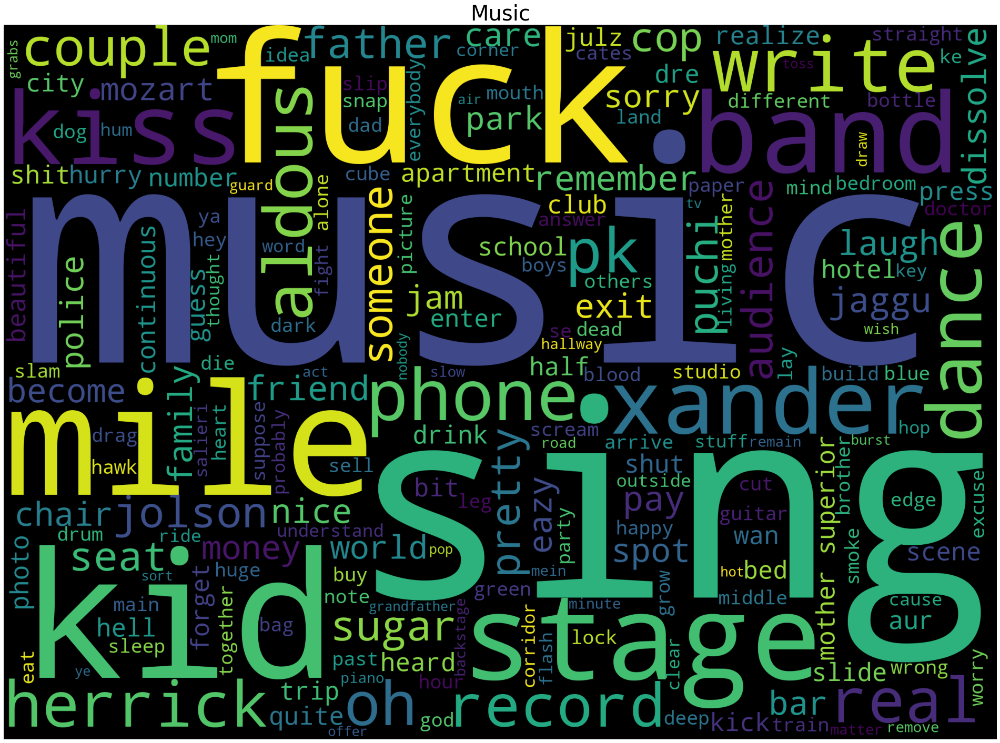

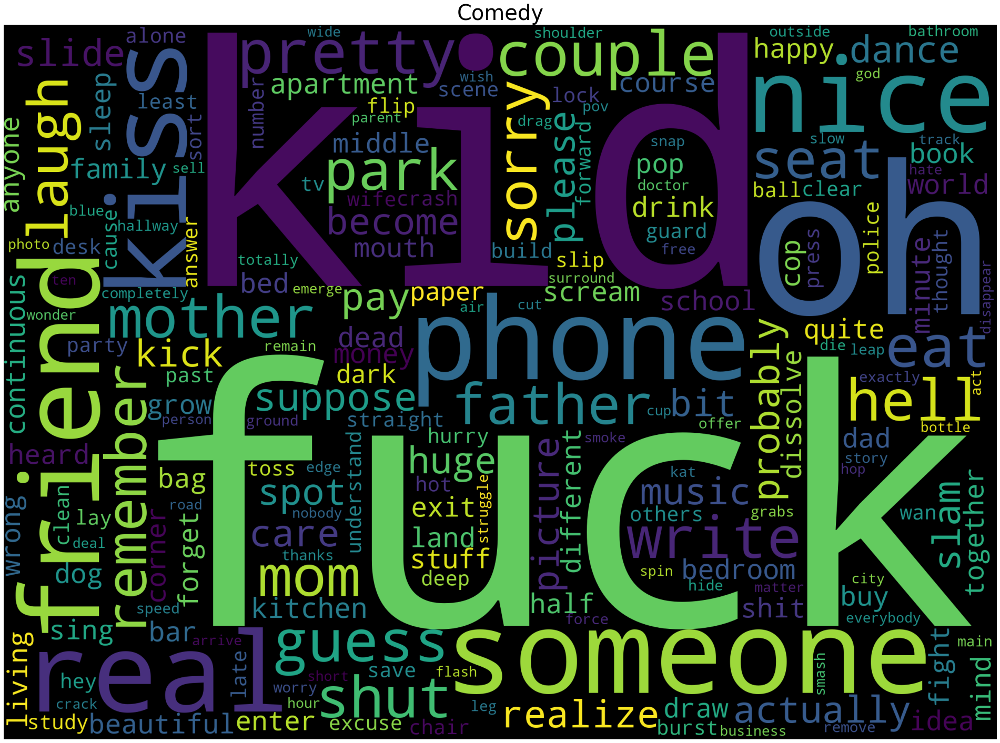

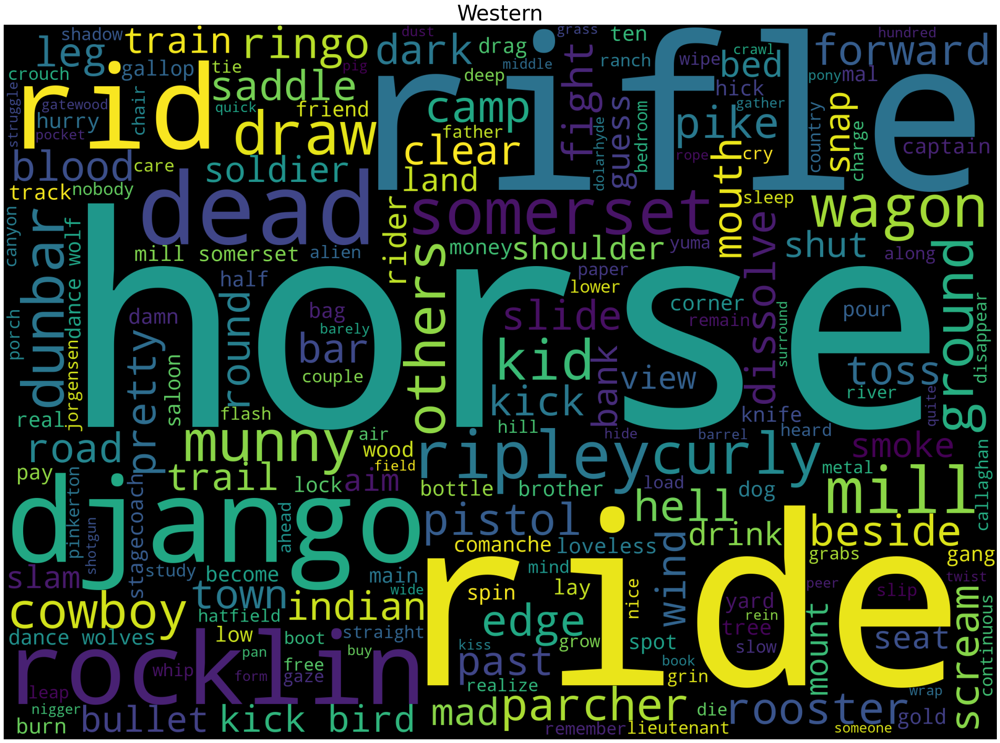

In [21]:
for i in genre_list: #creating word clouds for each genre with lemmatiziaon and stop words

    cloud(data[data[i] == 1].updated_words, genre=i)

#### There's clear distincition between the word clouds of the different genres. We'll utilize the lemmatizing and custom stopwords list in the text prerpocessing in order to create a better word matrix for classification

In [22]:
#saving data
data.to_csv('data/inter.csv')